## **Outlier Analysis of Aerosol Points**

By: Aaryan Doshi, Mentor: Dr. Lamb


Install pyroVED package:

In [ ]:
# Install the latest version from source
# (or you may instal a stable version from PyPi instead with !pip install pyroved)
!pip install -q git+https://github.com/ziatdinovmax/pyroved.git

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 91.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 72.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 38.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 18.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.3 MB/s eta 0:00:00


In [ ]:
import os
import math
import numpy as np
import seaborn as sns
import pandas as pd
import time
import random

import torch

from torch.nn import Conv1d, ConvTranspose1d
from torch.nn import Linear as Lin, ReLU, Sigmoid, ConstantPad1d
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import StratifiedKFold

from matplotlib import pyplot as plt
from tqdm import tqdm

In [ ]:
import pyroved as pv
import torch
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
X_train = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_train.npy")
Y_train = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_train.npy")

X_val = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_val.npy")
Y_val = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_val.npy")

X_test = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_test.npy")
Y_test = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_test.npy")

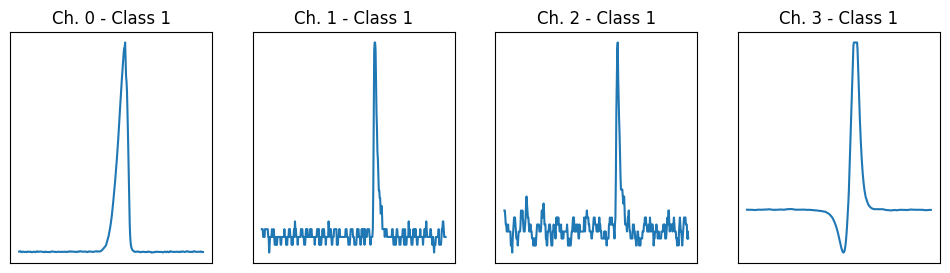

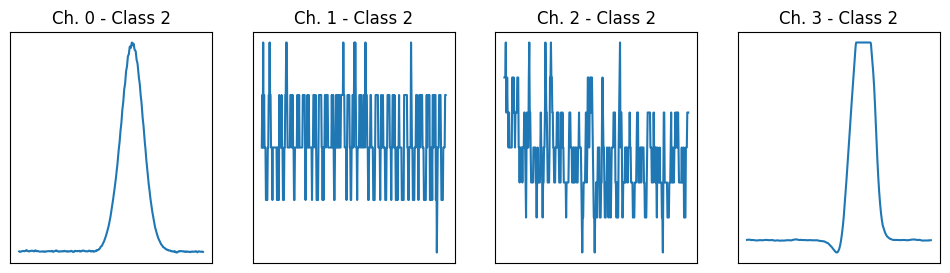

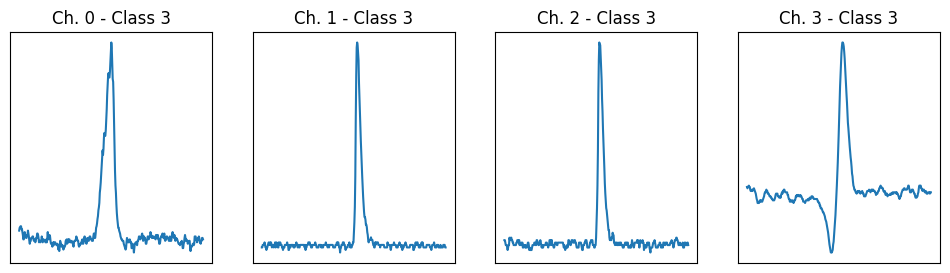

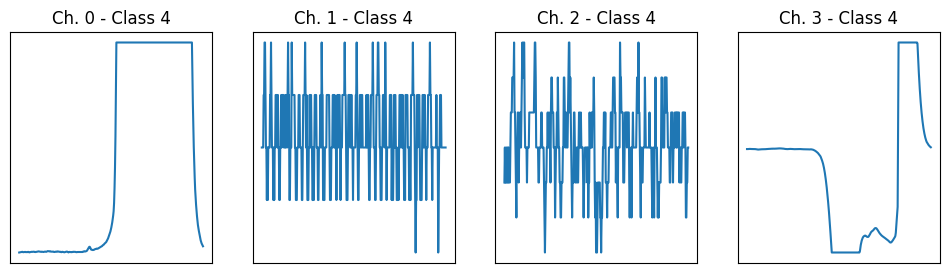

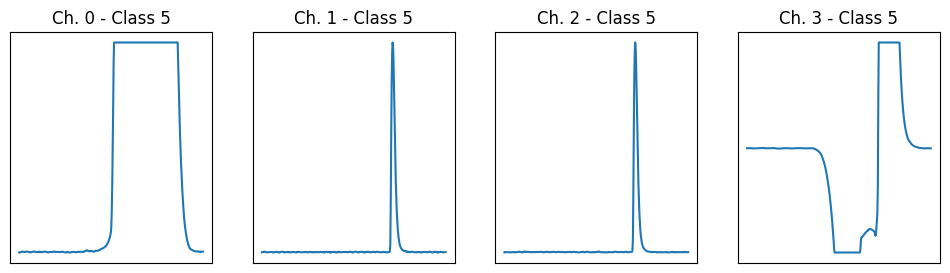

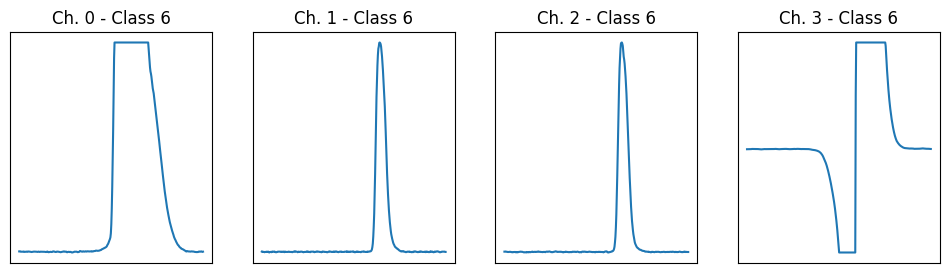

In [ ]:
import random
import matplotlib.pyplot as plt

for class_label in range(1, 7):
    class_indices = [i for i, label in enumerate(Y_train) if label == class_label]

    random_index = random.choice(class_indices)

    fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12, 3))
    axes[0].plot(X_train[random_index, :, 0])
    axes[0].set_title(f"Ch. 0 - Class {class_label}")
    axes[0].set_xticks([])
    axes[0].set_yticks([])
    axes[1].plot(X_train[random_index, :, 1])
    axes[1].set_title(f"Ch. 1 - Class {class_label}")
    axes[1].set_xticks([])
    axes[1].set_yticks([])
    axes[2].plot(X_train[random_index, :, 2])
    axes[2].set_title(f"Ch. 2 - Class {class_label}")
    axes[2].set_xticks([])
    axes[2].set_yticks([])
    axes[3].plot(X_train[random_index, :, 3])
    axes[3].set_title(f"Ch. 3 - Class {class_label}")
    axes[3].set_xticks([])
    axes[3].set_yticks([])

    plt.show()


[ 0.12933705  0.12326274  0.32842488 -0.01449814]
[ 0.22177819  0.01902713  0.02647253 -2.50885998]
[ 0.31917596 -0.0173726   0.05129054  0.3289653 ]
[ 0.28221809  0.02647253  0.037227   -0.4016109 ]
[ 0.26892813  0.06121774 -0.02150893 -0.5452912 ]


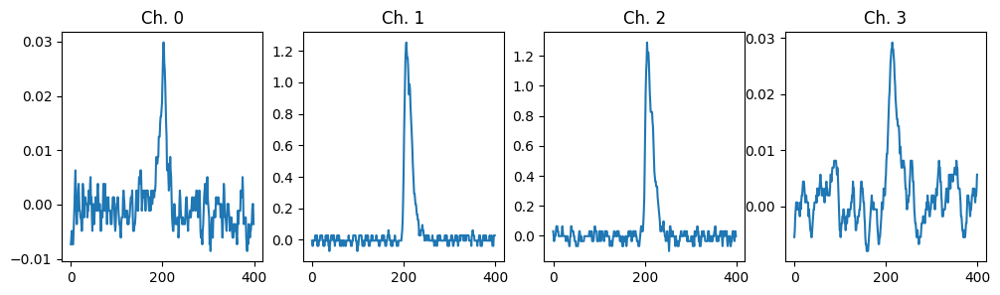

In [ ]:
n = random.randint(1, 140081)
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12,3))
axes[0].plot(X_train[n,:,0])
axes[0].set_title("Ch. 0")
axes[1].plot(X_train[n,:,1])
axes[1].set_title("Ch. 1")
axes[2].plot(X_train[n,:,2])
axes[2].set_title("Ch. 2")
axes[3].plot(X_train[n,:,3])
axes[3].set_title("Ch. 3")

random_indices = [random.randint(0, 140081) for _ in range(5)]

for idx in random_indices:
    print(X_train[idx, 199, :])

#print out the channel 0, 1, 2, 3, 4 for one random aerosol sample in X_train.
#this will be acorss a 400 point time series


In [ ]:
Y_train.shape

(140082,)

In [ ]:
#APPLY INCANDESCENT THRESHOLD
mask = np.any(X_train[:, :, 1] > 0.2, axis=1)
X_train = X_train[mask]
Y_train = Y_train[mask]

In [ ]:
import numpy as np

unique_classes_orig, class_counts_orig = np.unique(Y_train, return_counts=True)

mask = np.any(X_train[:, :, 1] > 0.2, axis=1)
X_train_filtered = X_train[mask]
Y_train_filtered = Y_train[mask]

unique_classes_after, class_counts_after = np.unique(Y_train_filtered, return_counts=True)

print("Different aerosol classes detectable incandesence:")
for cls in unique_classes_orig:
    count_orig = class_counts_orig[unique_classes_orig == cls][0]
    count_after = class_counts_after[unique_classes_after == cls][0] if cls in unique_classes_after else 0
    percentage_change = (count_after / count_orig) * 100 if count_orig > 0 else 0
    print(f"Class {cls}: Before = {count_orig}, After = {count_after}, Percentage = {percentage_change:.2f}%")

Different aerosol classes detectable incandesence:
Class 0.0: Before = 19660, After = 19660, Percentage = 100.00%
Class 1.0: Before = 16223, After = 16223, Percentage = 100.00%
Class 2.0: Before = 1706, After = 1706, Percentage = 100.00%
Class 3.0: Before = 4786, After = 4786, Percentage = 100.00%
Class 4.0: Before = 5402, After = 5402, Percentage = 100.00%
Class 5.0: Before = 18377, After = 18377, Percentage = 100.00%
Class 6.0: Before = 19678, After = 19678, Percentage = 100.00%


In [ ]:
original_max_X_train = np.zeros((len(X_train), 4))
for p_idx in range(len(X_train)):
  for c_idx in range(4):
    original_max_X_train[p_idx][c_idx] = np.max(X_train[p_idx, :, c_idx])


In [ ]:
peak_height = np.max(X_train[:, :, 1])
print(peak_height)

132.61664460622106


In [ ]:
#SATURATION NUMERIC

#creating a more accurate delta eps values.

# Specify  epsilon value, like how tolerant will be to change
eps = 0.001

# Step 1: Find the maximum signal per particle in Channel 0
max_signal_channel_0 = np.max(X_train[:, :, 0], axis=1)

# Step 2: Count the number of points within epsilon of the maximum for each particle in Channel 0
# This comparison now includes the epsilon tolerance around the maximum signal
count_max_signal_channel_0 = np.sum((X_train[:, :, 0] >= (max_signal_channel_0[:, np.newaxis] - eps)) &
                                    (X_train[:, :, 0] <= (max_signal_channel_0[:, np.newaxis] + eps)), axis=1)

print(count_max_signal_channel_0/400*100)
count_max_signal_channel_0.shape


[ 0.25  0.5   0.25 ... 14.25  8.75 28.75]


(85832,)

In [ ]:
max1 = np.max(X_train[:, :, 1], axis=1)
max2 = np.max(X_train[:, :, 2], axis=1)

# Calculate the color channel ratio for all 400 points
color_channel_ratio = max2 / max1

color_channel_ratio

array([1.11002002, 1.08262394, 1.21032505, ..., 1.52508171, 1.49707908,
       1.61149563])

In [ ]:
channel_min_X_train = np.zeros((len(X_train), 4))
channel_max_X_train = np.zeros((len(X_train), 4))

# WOULD APPLY SAME LOGIC TO VALIDATION AND TEST DATASETS

for p_idx in range(len(X_train)):
  for c_idx in range(4):
    channel_min_X_train[p_idx][c_idx] = np.min(X_train[p_idx, :, c_idx])

  for c_idx in range(4):
    channel_max_X_train[p_idx][c_idx] = np.max(X_train[p_idx, :, c_idx])


for p_idx in range (0,len(X_train)):
  for c_idx in range(0, 4):
    s0 = (X_train[p_idx,:,c_idx] - channel_min_X_train[p_idx][c_idx])/(channel_max_X_train[p_idx][c_idx]- channel_min_X_train[p_idx][c_idx])
    X_train[p_idx,:,c_idx] = s0

X_train

array([[[4.01606426e-03, 2.49376559e-03, 6.71140940e-03, 2.07009858e-01],
        [4.01606426e-03, 0.00000000e+00, 4.47427293e-03, 2.07009858e-01],
        [2.67737617e-03, 0.00000000e+00, 4.47427293e-03, 2.07009858e-01],
        ...,
        [5.35475234e-03, 2.49376559e-03, 6.71140940e-03, 2.07009858e-01],
        [1.07095047e-02, 2.49376559e-03, 1.11856823e-02, 2.07009858e-01],
        [8.03212851e-03, 2.49376559e-03, 8.94854586e-03, 2.07009858e-01]],

       [[1.90476190e-01, 5.76923077e-02, 7.01754386e-02, 3.93442623e-01],
        [1.90476190e-01, 5.76923077e-02, 7.01754386e-02, 3.77049180e-01],
        [2.38095238e-01, 3.84615385e-02, 5.26315789e-02, 3.93442623e-01],
        ...,
        [1.42857143e-01, 3.84615385e-02, 5.26315789e-02, 2.95081967e-01],
        [9.52380952e-02, 3.84615385e-02, 3.50877193e-02, 2.62295082e-01],
        [7.14285714e-02, 3.84615385e-02, 3.50877193e-02, 2.62295082e-01]],

       [[4.16666667e-01, 1.33333333e-01, 1.05263158e-01, 5.55555556e-01],
        

In [ ]:
print(type(X_train))

<class 'numpy.ndarray'>


In [ ]:
X_train_C0 = torch.from_numpy(X_train[:,:, 0]).float()

train_loader_0 = pv.utils.init_dataloader(X_train_C0.unsqueeze(1), batch_size=64)

fig, axes = plt.subplots(8, 8, figsize=(8, 8), dpi=300,
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, (y,) in zip(axes.flat, train_loader_0):
    y_use = y.numpy()
    ax.plot(y_use[0, 0])

plt.savefig('high_res_figure.png', dpi=300)
plt.close(fig)

from google.colab import files
files.download('high_res_figure.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
X_train_C1 = torch.from_numpy(X_train[:,:, 1]).float()

train_loader_1 = pv.utils.init_dataloader(X_train_C1.unsqueeze(1), batch_size=64)

fig, axes = plt.subplots(8, 8, figsize=(8, 8), dpi=300,
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, (y,) in zip(axes.flat, train_loader_1):
    y_use = y.numpy()
    ax.plot(y_use[0, 0])

plt.savefig('high_res_figure_channel_1.png', dpi=300)
plt.close(fig)

from google.colab import files
files.download('high_res_figure_channel_1.png')



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# COMPARE the effectiveness of PCA vs. VAE. Evaluate which method is better (VAE?)

import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist
from matplotlib.colors import ListedColormap

# applying PCA on channel 0
X_train_C0 = X_train[:, :, 0]
Y_train = Y_train

pca = PCA(n_components=2)
z_mean = pca.fit_transform(X_train_C0)

# Function to identify outliers based on a z-score threshold
def identify_outliers(latent_space, labels, z_threshold=3.0):
    unique_labels = np.unique(labels)
    outliers = []
    all_distances = []
    outlier_indices = []

    for label in unique_labels:
        cluster_points = latent_space[labels == label]
        centroid = cluster_points.mean(axis=0)
        distances = cdist(cluster_points, [centroid], metric='euclidean').flatten()
        all_distances.extend(distances)
        mean_distance = distances.mean()
        std_distance = distances.std()
        threshold = mean_distance + z_threshold * std_distance
        cluster_outliers = cluster_points[distances > threshold]
        outliers.append(cluster_outliers)
        outlier_indices.extend(np.where(labels == label)[0][distances > threshold])

    if outliers:
        all_outliers = np.vstack(outliers)
    else:
        all_outliers = np.array([]).reshape(0, latent_space.shape[1])

    return all_outliers, all_distances, outlier_indices

# plotting latent space w/ PCA
def plot_latent_space_with_threshold(z_threshold):
    outliers, all_distances, outlier_indices = identify_outliers(z_mean, Y_train, z_threshold)

    non_outlier_mask = np.ones(len(z_mean), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    # removing atd, cfa, va
    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    fig, axes = plt.subplots(1, 4, figsize=(60, 12), dpi=300)

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

    # original latent space
    im1 = axes[0].scatter(z_mean[:, 0], z_mean[:, 1], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    axes[0].set_title(f"Original Latent Space (z_threshold = {z_threshold})", fontsize=18)
    axes[0].set_xlabel("$z_1$", fontsize=16)
    axes[0].set_ylabel("$z_2$", fontsize=16)
    cbar1 = fig.colorbar(im1, ax=axes[0], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar1.set_ticklabels(target_names)
    cbar1.set_label("$\mu$", fontsize=16)

    # latent space w/o outliers
    im2 = axes[1].scatter(z_mean_filtered[:, 0], z_mean_filtered[:, 1], s=1, c=Y_train_filtered, cmap=cmap1, label='Data Points')
    axes[1].set_title("Latent Space without Outliers", fontsize=18)
    axes[1].set_xlabel("$z_1$", fontsize=16)
    axes[1].set_ylabel("$z_2$", fontsize=16)
    cbar2 = fig.colorbar(im2, ax=axes[1], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar2.set_ticklabels(target_names)
    cbar2.set_label("$\mu$", fontsize=16)

    # outliers in latent space
    im3 = axes[2].scatter(z_mean[:, 0], z_mean[:, 1], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    axes[2].scatter(outliers[:, 0], outliers[:, 1], s=10, c='black', marker='x', label='Outliers')
    axes[2].set_title("Outliers in Latent Space", fontsize=18)
    axes[2].set_xlabel("$z_1$", fontsize=16)
    axes[2].set_ylabel("$z_2$", fontsize=16)
    cbar3 = fig.colorbar(im3, ax=axes[2], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar3.set_ticklabels(target_names)
    cbar3.set_label("$\mu$", fontsize=16)
    axes[2].legend()

    # Latent space without specific classes
    im4 = axes[3].scatter(z_mean_class_filtered[:, 0], z_mean_class_filtered[:, 1], s=1, c=Y_train_class_filtered, cmap=cmap1, label='Data Points')
    axes[3].set_title("Latent Space without ATD, CFA, and VA", fontsize=18)
    axes[3].set_xlabel("$z_1$", fontsize=16)
    axes[3].set_ylabel("$z_2$", fontsize=16)
    cbar4 = fig.colorbar(im4, ax=axes[3], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar4.set_ticklabels(target_names)
    cbar4.set_label("$\mu$", fontsize=16)

plot_latent_space_with_threshold(3.0)
plot_latent_space_with_threshold(2.0)

plt.show()


In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(X_train_C0)
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)
print("Explained Variance Ratio:", explained_variance_ratio)
print("Cumulative Explained Variance:", cumulative_explained_variance)

Explained Variance Ratio: [0.56868212 0.17935585]
Cumulative Explained Variance: [0.56868212 0.74803798]


In [ ]:
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

#standardize data
scaler = StandardScaler()
X_train_C0_scaled = scaler.fit_transform(X_train_C0)
print("Standardized Data:\n", X_train_C0_scaled)


#apply PCA on this standardized data
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(X_train_C0_scaled)  # Reduce dimensionality

#reconstruct the data from the reduced components
X_reconstructed = pca.inverse_transform(X_reduced)  # Reconstruct from PCA components

#calculate reconstruction error (MSE) on the standardized data
pca_reconstruction_error = mean_squared_error(X_train_C0_scaled, X_reconstructed)
print("PCA Reconstruction Error (MSE):", pca_reconstruction_error)


Standardized Data:
 [[-0.3786292  -0.37908207 -0.38984828 ... -0.39587762 -0.36548626
  -0.37781494]
 [ 1.0732798   1.06980527  1.43422593 ...  0.35346479  0.09451588
  -0.03318958]
 [ 2.83455697  4.1224992   4.75490056 ...  2.29977477  3.20421362
   3.65554914]
 ...
 [-0.37313669 -0.37360099 -0.37766869 ... -0.40962109 -0.41092012
  -0.40607835]
 [-0.37315404 -0.3736183  -0.38134079 ... -0.42248743 -0.4211989
  -0.41634713]
 [-0.3915102  -0.38826574 -0.38497316 ... -0.4096138  -0.41348466
  -0.41377448]]
PCA Reconstruction Error (MSE): 0.31429181280971524


In [ ]:
vae = pv.models.iVAE(data_dim = (400,), latent_dim = 2, invariances=None, seed=0)

Our goal is to find the real/physical descriptor of the data set in an unsupervised fashion, while ignoring (or separating) relative positions of the peaks. First, let's train a regular VAE:

In [ ]:
channel_0 = (140081, )

# Initialize vanilla VAE
# Insert the color channel ratio here?

vae = pv.models.iVAE(data_dim = (400,), latent_dim = 2, invariances=None, sampler_d = 'gaussian', seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(55):
    trainer.step(train_loader_0)
    trainer.print_statistics()

Epoch: 1 Training loss: 104.4200
Epoch: 2 Training loss: 100.6044
Epoch: 3 Training loss: 100.1407
Epoch: 4 Training loss: 99.8667
Epoch: 5 Training loss: 99.6331
Epoch: 6 Training loss: 99.4703
Epoch: 7 Training loss: 99.3105
Epoch: 8 Training loss: 99.2287
Epoch: 9 Training loss: 99.1521
Epoch: 10 Training loss: 99.0970
Epoch: 11 Training loss: 99.0245
Epoch: 12 Training loss: 98.9767
Epoch: 13 Training loss: 99.0115
Epoch: 14 Training loss: 98.9151
Epoch: 15 Training loss: 98.8930
Epoch: 16 Training loss: 98.8665
Epoch: 17 Training loss: 98.8342
Epoch: 18 Training loss: 98.7702
Epoch: 19 Training loss: 98.7897
Epoch: 20 Training loss: 98.7812
Epoch: 21 Training loss: 98.7365
Epoch: 22 Training loss: 98.7207
Epoch: 23 Training loss: 98.6955
Epoch: 24 Training loss: 98.7381
Epoch: 25 Training loss: 98.6980
Epoch: 26 Training loss: 98.6627
Epoch: 27 Training loss: 98.6660
Epoch: 28 Training loss: 98.6539
Epoch: 29 Training loss: 98.6138
Epoch: 30 Training loss: 98.6107
Epoch: 31 Traini

In [ ]:
channel_1 = (140081, )

# Initialize vanilla VAE
# Insert the color channel ratio here?

vae = pv.models.iVAE(data_dim = (400,), latent_dim = 2, invariances=None, sampler_d = 'gaussian', seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(55):
    trainer.step(train_loader_1)
    trainer.print_statistics()

Epoch: 1 Training loss: 101.7920
Epoch: 2 Training loss: 97.3860
Epoch: 3 Training loss: 96.9796
Epoch: 4 Training loss: 96.8107
Epoch: 5 Training loss: 96.6665
Epoch: 6 Training loss: 96.5854
Epoch: 7 Training loss: 96.5147
Epoch: 8 Training loss: 96.4559
Epoch: 9 Training loss: 96.4174
Epoch: 10 Training loss: 96.3852
Epoch: 11 Training loss: 96.3549
Epoch: 12 Training loss: 96.3497
Epoch: 13 Training loss: 96.3227
Epoch: 14 Training loss: 96.2993
Epoch: 15 Training loss: 96.2798
Epoch: 16 Training loss: 96.2733
Epoch: 17 Training loss: 96.2565
Epoch: 18 Training loss: 96.2391
Epoch: 19 Training loss: 96.2350
Epoch: 20 Training loss: 96.2374
Epoch: 21 Training loss: 96.2102
Epoch: 22 Training loss: 96.2110
Epoch: 23 Training loss: 96.2028
Epoch: 24 Training loss: 96.1815
Epoch: 25 Training loss: 96.1786
Epoch: 26 Training loss: 96.1649
Epoch: 27 Training loss: 96.1493
Epoch: 28 Training loss: 96.1473
Epoch: 29 Training loss: 96.1338
Epoch: 30 Training loss: 96.1301
Epoch: 31 Training

**ANALYZING OUTLIERS + Encode the training data into the latent space:**

Class 0.0: 36.98% of points classified as outliers.
Class 1.0: 46.66% of points classified as outliers.
Class 2.0: 43.85% of points classified as outliers.
Class 3.0: 42.19% of points classified as outliers.
Class 4.0: 45.91% of points classified as outliers.
Class 5.0: 20.64% of points classified as outliers.
Class 6.0: 37.86% of points classified as outliers.
Class 0.0: 5.38% of points classified as outliers.
Class 1.0: 3.50% of points classified as outliers.
Class 2.0: 4.04% of points classified as outliers.
Class 3.0: 3.74% of points classified as outliers.
Class 4.0: 5.07% of points classified as outliers.
Class 5.0: 5.69% of points classified as outliers.
Class 6.0: 6.11% of points classified as outliers.


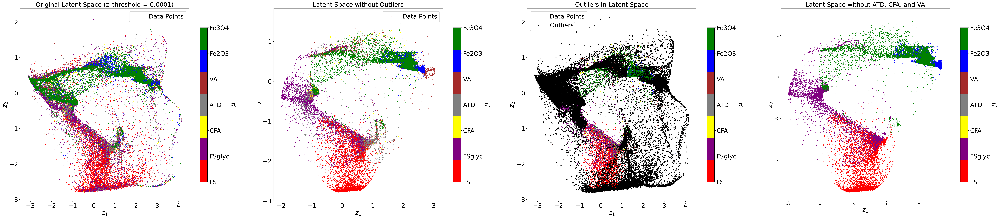

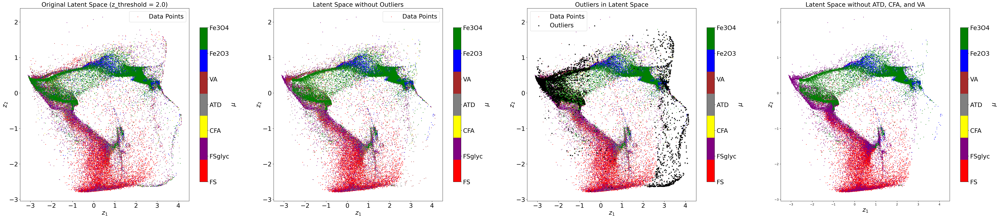

In [ ]:
# 2D PLOTS (NON-ADAPTIVE VERSION) --> CHANNEL 0

# ANALYZING OUTLIERS
from scipy.spatial.distance import cdist
from matplotlib.colors import ListedColormap

global outlier_indices

def identify_outliers_with_percentages(latent_space, labels, z_threshold=3.0):
    unique_labels = np.unique(labels)
    outliers = []
    all_distances = []
    outlier_indices = []
    # to implement outlier percentage by class
    outlier_percentages = {}

    for label in unique_labels:
        cluster_points = latent_space[labels == label]
        total_points = len(cluster_points)
        centroid = cluster_points.mean(axis=0)
        distances = cdist(cluster_points, [centroid], metric='euclidean').flatten()
        all_distances.extend(distances)
        mean_distance = distances.mean()
        std_distance = distances.std()
        threshold = mean_distance + z_threshold * std_distance
        cluster_outliers = cluster_points[distances > threshold]

        # calculating % of outliers per class (fly ash, dust, etc.)
        # per class basis
        num_outliers = len(cluster_outliers)
        outlier_percent = (num_outliers / total_points) * 100 if total_points > 0 else 0
        outlier_percentages[label] = outlier_percent

        outliers.append(cluster_outliers)
        outlier_indices.extend(np.where(labels == label)[0][distances > threshold])

    if outliers:
        all_outliers = np.vstack(outliers)
    else:
        all_outliers = np.array([]).reshape(0, latent_space.shape[1])

    return all_outliers, all_distances, outlier_indices, outlier_percentages

def plot_latent_space_with_threshold(z_threshold):
    # Use updated function to calculate outliers and percentages
    outliers, all_distances, outlier_indices, outlier_percentages = identify_outliers_with_percentages(z_mean, Y_train, z_threshold)

    # Print percentage of outliers for each class
    for label, percentage in outlier_percentages.items():
        print(f"Class {label}: {percentage:.2f}% of points classified as outliers.")

    non_outlier_mask = np.ones(len(z_mean), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    # removing atd, cfa, va
    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    fig, axes = plt.subplots(1, 4, figsize=(60, 12), dpi=300)

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

    # trying to plot the original latent space
    im1 = axes[0].scatter(z_mean[:, -1], z_mean[:, -2], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    axes[0].set_title(f"Original Latent Space (z_threshold = {z_threshold})", fontsize=21)
    axes[0].set_xlabel("$z_1$", fontsize=21)
    axes[0].set_ylabel("$z_2$", fontsize=21)
    axes[0].legend(fontsize=21)
    axes[0].tick_params(axis='both', which='major', labelsize=21)
    cbar1 = fig.colorbar(im1, ax=axes[0], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar1.set_ticklabels(target_names, fontsize=21)
    cbar1.set_label("$\mu$", fontsize=21)

    # trying to plot the latent space without outliers
    im2 = axes[1].scatter(z_mean_filtered[:, -1], z_mean_filtered[:, -2], s=1, c=Y_train_filtered, cmap=cmap1, label='Data Points')
    axes[1].set_title("Latent Space without Outliers", fontsize=21)
    axes[1].set_xlabel("$z_1$", fontsize=21)
    axes[1].set_ylabel("$z_2$", fontsize=21)
    axes[1].legend(fontsize=21)
    axes[1].tick_params(axis='both', which='major', labelsize=21)
    cbar2 = fig.colorbar(im2, ax=axes[1], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar2.set_ticklabels(target_names, fontsize=21)
    cbar2.set_label("$\mu$", fontsize=21)

    # trying to plot the outliers specifically
    im3 = axes[2].scatter(z_mean[:, -1], z_mean[:, -2], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    axes[2].scatter(outliers[:, -1], outliers[:, -2], s=10, c='black', marker='x', label='Outliers')
    axes[2].set_title("Outliers in Latent Space", fontsize=21)
    axes[2].set_xlabel("$z_1$", fontsize=21)
    axes[2].set_ylabel("$z_2$", fontsize=21)
    axes[2].legend(fontsize=21)
    axes[2].tick_params(axis='both', which='major', labelsize=21)
    cbar3 = fig.colorbar(im3, ax=axes[2], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar3.set_ticklabels(target_names, fontsize=21)
    cbar3.set_label("$\mu$", fontsize=21)

    # this one to have latent space wo specific classes
    im4 = axes[3].scatter(z_mean_class_filtered[:, -1], z_mean_class_filtered[:, -2], s=1, c=Y_train_class_filtered, cmap=cmap1, label='Data Points')
    axes[3].set_title("Latent Space without ATD, CFA, and VA", fontsize=21)
    axes[3].set_xlabel("$z_1$", fontsize=21)
    axes[3].set_ylabel("$z_2$", fontsize=21)
    axes[2].legend(fontsize=21)
    axes[2].tick_params(axis='both', which='major', labelsize=21)
    cbar4 = fig.colorbar(im4, ax=axes[3], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar4.set_ticklabels(target_names, fontsize=21)
    cbar4.set_label("$\mu$", fontsize=21)

z_mean, z_sd = vae.encode(X_train_C0)

plot_latent_space_with_threshold(0.0001)
plot_latent_space_with_threshold(2.0)

plt.show()


In [ ]:
# 2D PLOTS (NON-ADAPTIVE VERSION) --> CHANNEL 1

import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
from matplotlib.colors import ListedColormap

def identify_outliers_with_percentages(latent_space, labels, z_threshold=3.0):
    unique_labels = np.unique(labels)
    outliers = []
    all_distances = []
    outlier_indices = []
    outlier_percentages = {}

    for label in unique_labels:
        cluster_points = latent_space[labels == label]
        total_points = len(cluster_points)  # Total points in the cluster
        global_centroid = cluster_points.mean(axis=0)
        distances = cdist(cluster_points, [global_centroid], metric='euclidean').flatten()
        all_distances.extend(distances)
        mean_distance = distances.mean()
        std_distance = distances.std()
        threshold = mean_distance + z_threshold * std_distance
        cluster_outliers = cluster_points[distances > threshold]

        # calculating % of outliers per class (fly ash, dust, etc.)
        # per class basis
        num_outliers = len(cluster_outliers)
        outlier_percent = (num_outliers / total_points) * 100 if total_points > 0 else 0
        outlier_percentages[label] = outlier_percent

        outliers.append(cluster_outliers)
        outlier_indices.extend(np.where(labels == label)[0][distances > threshold])



        # try testing if we should do this not on a per class basis. But instead over all the total points
        # distance from the center of all particles (but could be heavily biased)
        # do the line plot for z_threshold as what is able to classify the outliers the best



    if outliers:
        all_outliers = np.vstack(outliers)
    else:
        all_outliers = np.array([]).reshape(0, latent_space.shape[1])

    return all_outliers, all_distances, outlier_indices, outlier_percentages

def plot_latent_space_with_threshold(z_threshold):
    # Use updated function to calculate outliers and percentages
    outliers, all_distances, outlier_indices, outlier_percentages = identify_outliers_with_percentages(z_mean_1, Y_train, z_threshold)

    # Print percentage of outliers for each class
    for label, percentage in outlier_percentages.items():
        print(f"Class {label}: {percentage:.2f}% of points classified as outliers.")

    non_outlier_mask = np.ones(len(z_mean_1), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean_1[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    fig, axs = plt.subplots(1, 3, figsize=(24, 8), dpi=300)

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

    font_size = 12
    colorbar_shrink = 0.5

    # Plot original latent space
    im1 = axs[0].scatter(z_mean_1[:, -1], z_mean_1[:, -2], s=1, c=Y_train, cmap=cmap1)
    axs[0].set_title(f"Original Latent Space (z_threshold = {z_threshold})", fontsize=font_size)
    axs[0].set_xlabel("$z_2$", fontsize=font_size)
    axs[0].set_ylabel("$z_3$", fontsize=font_size)
    cbar1 = fig.colorbar(im1, ax=axs[0], ticks=range(len(cmap1.colors)), shrink=colorbar_shrink)
    cbar1.set_ticklabels(target_names)
    cbar1.set_label("$\mu$", fontsize=font_size)

    # Plot latent space without outliers
    im2 = axs[1].scatter(z_mean_filtered[:, -1], z_mean_filtered[:, -2], s=1, c=Y_train_filtered, cmap=cmap1)
    axs[1].set_title("Latent Space without Outliers", fontsize=font_size)
    axs[1].set_xlabel("$z_2$", fontsize=font_size)
    axs[1].set_ylabel("$z_3$", fontsize=font_size)
    cbar2 = fig.colorbar(im2, ax=axs[1], ticks=range(len(cmap1.colors)), shrink=colorbar_shrink)
    cbar2.set_ticklabels(target_names)
    cbar2.set_label("$\mu$", fontsize=font_size)

    # Plot the outliers specifically
    im3 = axs[2].scatter(z_mean_1[:, -2], z_mean_1[:, -1], s=1, c=Y_train, cmap=cmap1)
    axs[2].scatter(outliers[:, -2], outliers[:, -1], s=10, c='black', marker='x', label='Outliers')
    axs[2].set_title("Outliers in Latent Space", fontsize=font_size)
    axs[2].set_xlabel("$z_2$", fontsize=font_size)
    axs[2].set_ylabel("$z_3$", fontsize=font_size)
    cbar3 = fig.colorbar(im3, ax=axs[2], ticks=range(len(cmap1.colors)), shrink=colorbar_shrink)
    cbar3.set_ticklabels(target_names)
    cbar3.set_label("$\mu$", fontsize=font_size)
    axs[2].legend(fontsize=font_size)

    plt.show()

z_mean_1, z_sd_1 = vae.encode(X_train_C1)

plot_latent_space_with_threshold(3.0)
plot_latent_space_with_threshold(2.0)


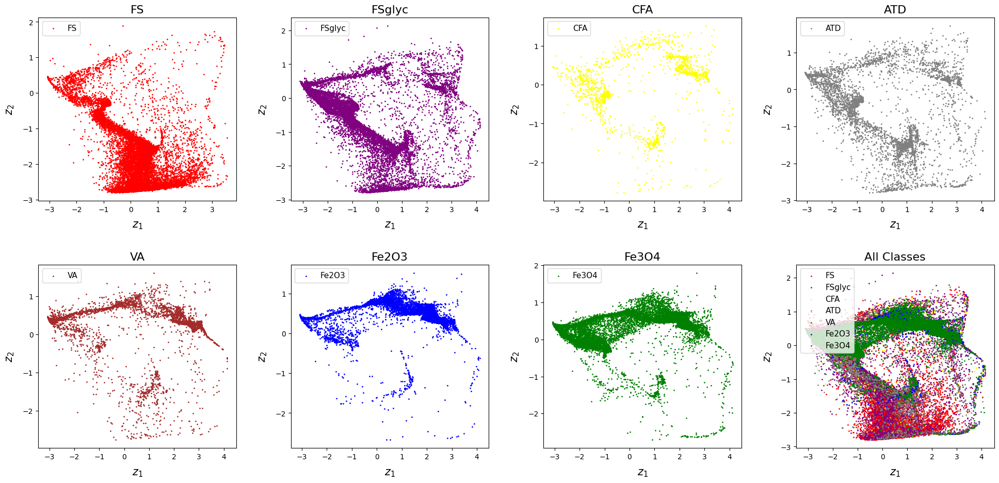

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#2D Channel 0

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np
from google.colab import files

z_mean, z_sd = vae.encode(X_train_C0)

target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

fig, axs = plt.subplots(2, 4, figsize=(20, 10))

for idx_0 in range(7):
    class_indices = np.where(Y_train == idx_0)
    z_mean_class = z_mean[class_indices]

    ax = axs[idx_0 // 4, idx_0 % 4]
    ax.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_0), label=target_names[idx_0])
    ax.set_xlabel("$z_1$", fontsize=15, labelpad=10)
    ax.set_ylabel("$z_2$", fontsize=15, labelpad=10)
    ax.legend(fontsize=11, loc='upper left')
    ax.set_title(target_names[idx_0], fontsize=16)

ax_all = axs[1, 3]
for idx_0 in range(7):
    class_indices = np.where(Y_train == idx_0)
    z_mean_class = z_mean[class_indices]
    ax_all.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_0), label=target_names[idx_0])

ax_all.set_xlabel("$z_1$", fontsize=15, labelpad=10)
ax_all.set_ylabel("$z_2$", fontsize=15, labelpad=10)
ax_all.legend(fontsize=11, loc='upper left')
ax_all.set_title("All Classes", fontsize=16)

plt.tight_layout(pad=3.0)
filename = 'individualAerosolClass.png'
plt.savefig(filename, dpi=300)
plt.show()

# High Resolution Download
files.download(filename)



In [ ]:
#2D Channel 1

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np
from google.colab import files

z_mean_1, z_sd_1 = vae.encode(X_train_C1)

target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

fig, axs = plt.subplots(2, 4, figsize=(20, 10))

for idx_1 in range(7):
    class_indices = np.where(Y_train == idx_1)
    z_mean_class = z_mean_1[class_indices]

    ax = axs[idx_1 // 4, idx_1 % 4]
    ax.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_1), label=target_names[idx_1])
    ax.set_xlabel("$z_1$", fontsize=15, labelpad=10)
    ax.set_ylabel("$z_2$", fontsize=15, labelpad=10)
    ax.legend(fontsize=11, loc='upper left')
    ax.set_title(target_names[idx_1], fontsize=16)

# For the combined plot
ax_all = axs[1, 3]
for idx_1 in range(7):
    class_indices = np.where(Y_train == idx_1)
    z_mean_class = z_mean_1[class_indices]
    ax_all.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_1), label=target_names[idx_1])

ax_all.set_xlabel("$z_1$", fontsize=15, labelpad=10)
ax_all.set_ylabel("$z_2$", fontsize=15, labelpad=10)
ax_all.legend(fontsize=11, loc='upper left')
ax_all.set_title("All Classes", fontsize=16)

plt.tight_layout(pad=3.0)
filename = 'individualAerosolClass_1.png'
plt.savefig(filename, dpi=300)
plt.show()

# High Resolution Download
files.download(filename)


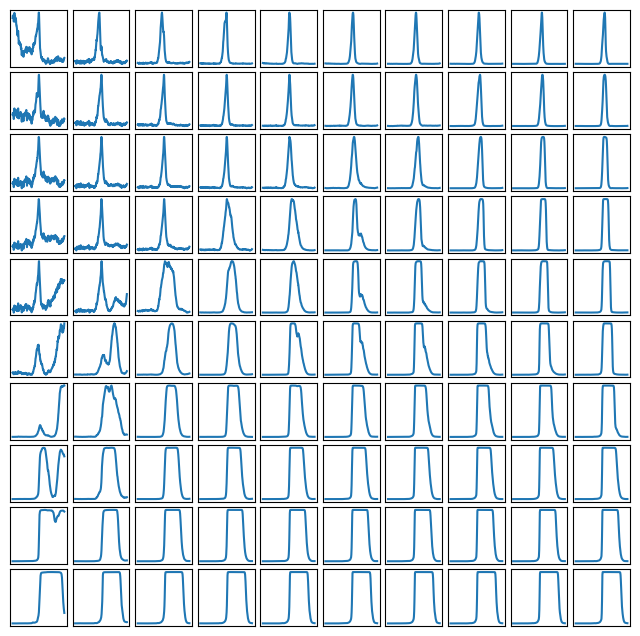

tensor([[0.6035, 0.6079, 0.6282,  ..., 0.1920, 0.1963, 0.1979],
        [0.1689, 0.1655, 0.1749,  ..., 0.1708, 0.1745, 0.1785],
        [0.0615, 0.0598, 0.0629,  ..., 0.0723, 0.0748, 0.0771],
        ...,
        [0.0025, 0.0027, 0.0026,  ..., 0.0062, 0.0062, 0.0060],
        [0.0024, 0.0026, 0.0025,  ..., 0.0063, 0.0062, 0.0060],
        [0.0025, 0.0026, 0.0026,  ..., 0.0067, 0.0065, 0.0064]])

In [ ]:
vae.manifold2d(d = 10)

In [ ]:
outliers, all_distances, outlier_indices = identify_outliers(z_mean_1, Y_train, 3.0)
random_outlier_index = random.choice(outlier_indices)
print(random_outlier_index)

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12, 3))
axes[0].plot(X_train[random_outlier_index, :, 0])
axes[0].set_title("Ch. 0")
axes[1].plot(X_train[random_outlier_index, :, 1])
axes[1].set_title("Ch. 1")
axes[2].plot(X_train[random_outlier_index, :, 2])
axes[2].set_title("Ch. 2")
axes[3].plot(X_train[random_outlier_index, :, 3])
axes[3].set_title("Ch. 3")

plt.tight_layout()
plt.show()

print("Channel values for just this selected outlier at index", random_outlier_index)
for ch in range(4):
    print(f"Channel {ch} at [time] point 199:", X_train[random_outlier_index, 199, ch])